In [1]:
# Created on Tue Jul 25 11:48:54 2023
# @author: mbeiran
# Plots the connectivity matrix 

In [2]:
from pathlib import Path

import pandas as pd
import numpy as np
from scipy import sparse 
import matplotlib.pyplot as plt
from matplotlib.offsetbox import AnchoredText

from connectome_tools import load_flywire

In [4]:
# Select output path for figures
figurepath = Path("fig")
figurepath.mkdir(exist_ok=True)

# Load data
datapath = Path("/Path/to/your/data")
neurons, _ = load_flywire(datapath)
N = len(neurons)

In [4]:
neurons.head()

,root_id,group,nt_type,nt_type_score,da_avg,ser_avg,gaba_avg,glut_avg,ach_avg,oct_avg,flow,super_class,class,sub_class,cell_type,hemibrain_type,hemilineage,side,nerve,J_idx,J_idx_post,J_idx_pre
0,720575940596125868,LO.LOP,ACH,0.57,0.03,0.00,0.05,0.28,0.57,0.07,intrinsic,optic,NaN,NaN,T5c,NaN,NaN,right,NaN,0,0,0
1,720575940597856265,ME,ACH,0.85,0.01,0.00,0.03,0.04,0.85,0.07,intrinsic,optic,NaN,NaN,Tm16,NaN,NaN,right,NaN,1,1,1
2,720575940597944841,ME.LO,ACH,0.82,0.02,0.00,0.01,0.05,0.82,0.09,intrinsic,optic,NaN,NaN,CB3851,NaN,NaN,right,NaN,2,2,2
3,720575940598267657,ME,GABA,0.74,0.01,0.01,0.74,0.19,0.03,0.02,intrinsic,optic,NaN,NaN,TmY15,NaN,NaN,right,NaN,3,3,3
4,720575940599333574,ME,ACH,0.61,0.02,0.00,0.13,0.13,0.61,0.11,intrinsic,optic,NaN,NaN,Tm1,NaN,NaN,right,NaN,4,4,4


In [5]:
# Load connections
conns = pd.read_csv(datapath / "connections.csv")
nt_types = np.unique(conns.nt_type)
nt_signs = {"GABA": -1, "GLUT": -1, "ACH": +1, "DA": 0, "OCT": 0, "SER": 0}
connections_gr = conns.groupby(by=['pre_root_id', 'post_root_id', 'nt_type'], as_index=False).sum()

conns.head()

,pre_root_id,post_root_id,neuropil,syn_count,nt_type
0,720575940629970489,720575940631267655,AVLP_R,7,GABA
1,720575940605876866,720575940606514878,LAL_R,15,GABA
2,720575940627737365,720575940628914436,AL_L,32,ACH
3,720575940633587552,720575940626452879,SMP_R,15,ACH
4,720575940616871878,720575940621203973,AVLP_L,13,GABA


In [6]:
def make_sparse_matrix(connections, match, assign_sign=True, neurotransmitter="all", neuropil="all", form = 'csc'):
    if neurotransmitter != "all":
        connections = connections[connections.nt_type == neurotransmitter]
    if neuropil != "all":
        connections = connections[connections.neuronpil == neuropil]
    pre_idxs = np.array([match[pre_idx] for pre_idx in connections.pre_root_id])
    post_idxs = np.array([match[post_idx] for post_idx in connections.post_root_id])
    values = np.array(connections.syn_count)
    if assign_sign:
        signs = np.asarray([nt_signs[nt_t] for nt_t in connections.nt_type])
        values = signs * values
    if form == 'csr':
        Mat = sparse.coo_matrix((values, (post_idxs, pre_idxs)), shape=(N, N)).tocsr()
    elif form=='csc':
        Mat = sparse.coo_matrix((values, (post_idxs, pre_idxs)), shape=(N, N)).tocsc()
    else:
        Mat = sparse.coo_matrix((values, (post_idxs, pre_idxs)), shape=(N, N))
    return Mat

In [7]:
def prepare_plot():
    plt.style.use('ggplot')
    
    fig_width = 1.5*2.2 # width in inches
    fig_height = 1.5*2.2  # height in inches
    fig_size =  [fig_width,fig_height]
    plt.rcParams['figure.figsize'] = fig_size
    plt.rcParams['figure.autolayout'] = True
     
    plt.rcParams['lines.linewidth'] = 1.2
    plt.rcParams['lines.markeredgewidth'] = 0.003
    plt.rcParams['lines.markersize'] = 3
    plt.rcParams['font.size'] = 14#9
    plt.rcParams['legend.fontsize'] = 11#7.
    plt.rcParams['axes.facecolor'] = '1'
    plt.rcParams['axes.edgecolor'] = '0'
    plt.rcParams['axes.linewidth'] = '0.7'
    
    plt.rcParams['axes.labelcolor'] = '0'
    plt.rcParams['axes.labelsize'] = 14#9
    plt.rcParams['xtick.labelsize'] = 11#7
    plt.rcParams['ytick.labelsize'] = 11#7
    plt.rcParams['xtick.color'] = '0'
    plt.rcParams['ytick.color'] = '0'
    plt.rcParams['xtick.major.size'] = 2
    plt.rcParams['ytick.major.size'] = 2
    
    plt.rcParams['font.sans-serif'] = 'Arial'
    plt.rcParams["axes.grid"] = False

prepare_plot()

In [8]:
match = {}
for n in range(len(neurons)):
    match[neurons.root_id.iloc[n]] = n

count = 0
match2 = np.zeros(len(neurons))
for n in range(len(neurons)):
    if neurons.nt_type.iloc[n]=='ACH':
        match[neurons.root_id.iloc[n]] = count 
        match2[n] = count
        count +=1
for n in range(len(neurons)):
    if neurons.nt_type.iloc[n]=='GLUT':
        match[neurons.root_id.iloc[n]] = count 
        match2[n] = count
        count +=1
for n in range(len(neurons)):
    if neurons.nt_type.iloc[n]=='GAB':
        match[neurons.root_id.iloc[n]] = count 
        match2[n] = count
        count +=1
for n in range(len(neurons)):
    if neurons.nt_type.iloc[n]!='GAB' and neurons.nt_type.iloc[n]!='GLUT' and neurons.nt_type.iloc[n]!='ACH':
        match[neurons.root_id.iloc[n]] = count 
        match2[n] = count
        count +=1


W = make_sparse_matrix(connections_gr, match, assign_sign=True, neurotransmitter="all")
Wr = make_sparse_matrix(connections_gr, match, assign_sign=True, neurotransmitter="all", form='csr')
Wco = make_sparse_matrix(connections_gr, match, assign_sign=True, neurotransmitter="all", form='coo')


Wall = make_sparse_matrix(conns, match, assign_sign=False, neurotransmitter="all")
W_ns = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="all")

W_gaba = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="GABA")
W_glut = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="GLUT")
W_ach  = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="ACH")


W_gaba_co = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="GABA", form='coo')
W_glut_co = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="GLUT", form='coo')
W_ach_co  = make_sparse_matrix(connections_gr, match, assign_sign=False, neurotransmitter="ACH", form='coo')

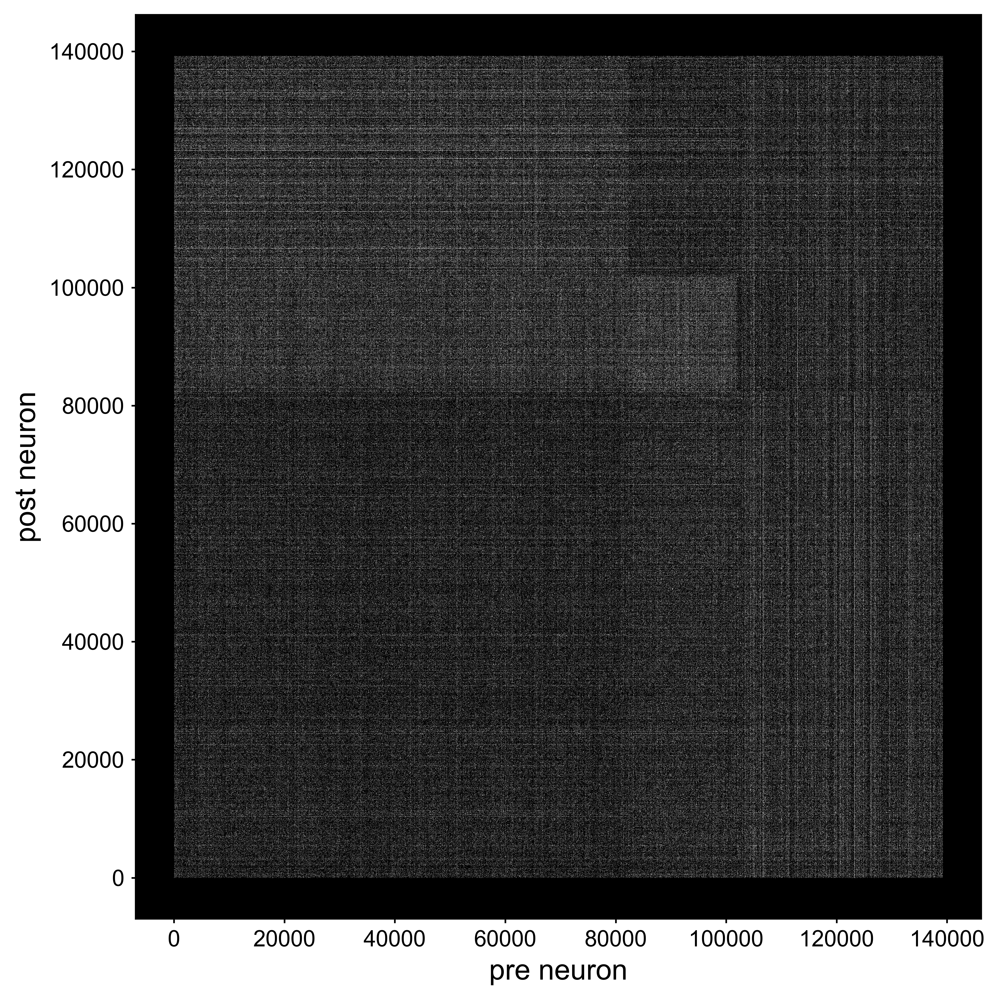

In [9]:
prepare_plot()
Cols  = ['C0', 'C1', 'C5']
#%%
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(Wco.col, Wco.row, 's', color='white', ms=0.1)

plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency.png')
plt.show()

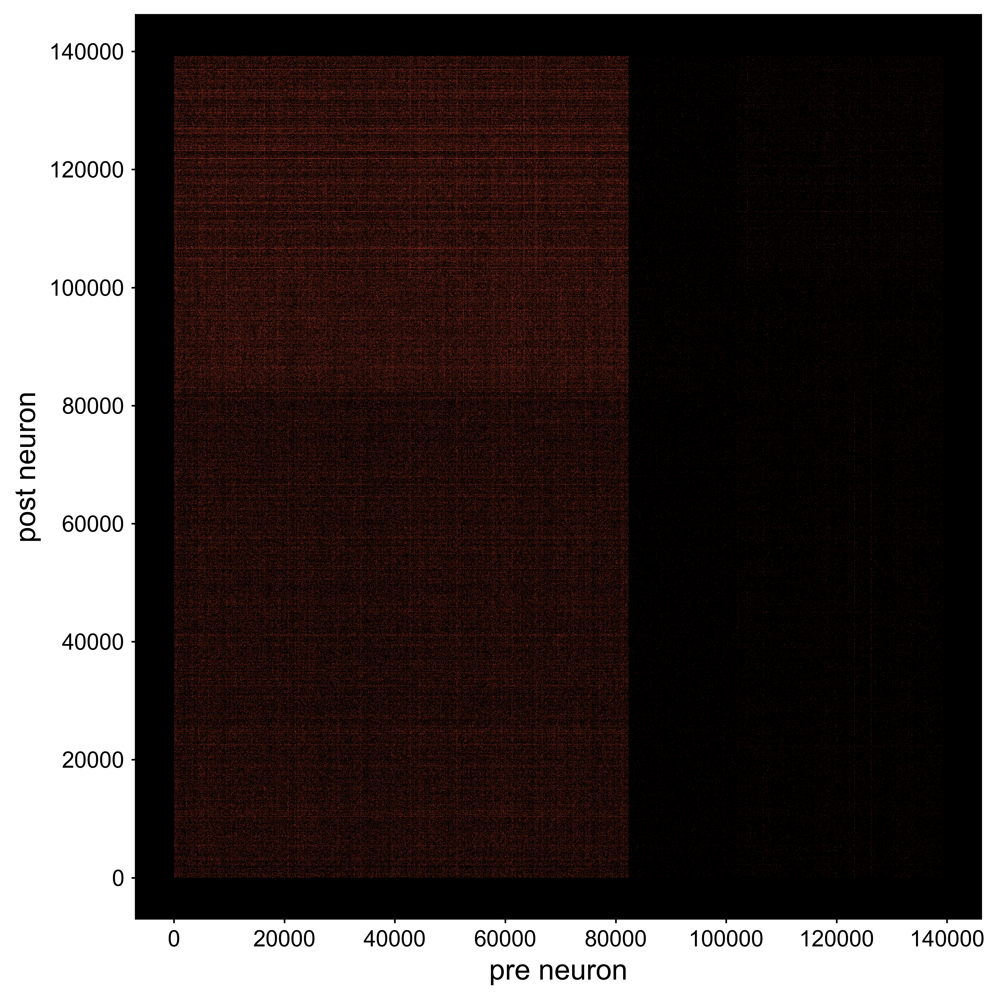

In [10]:
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(W_ach_co.col, W_ach_co.row, 's', color=Cols[0], ms=0.1)

plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency_ach.png')
plt.show()

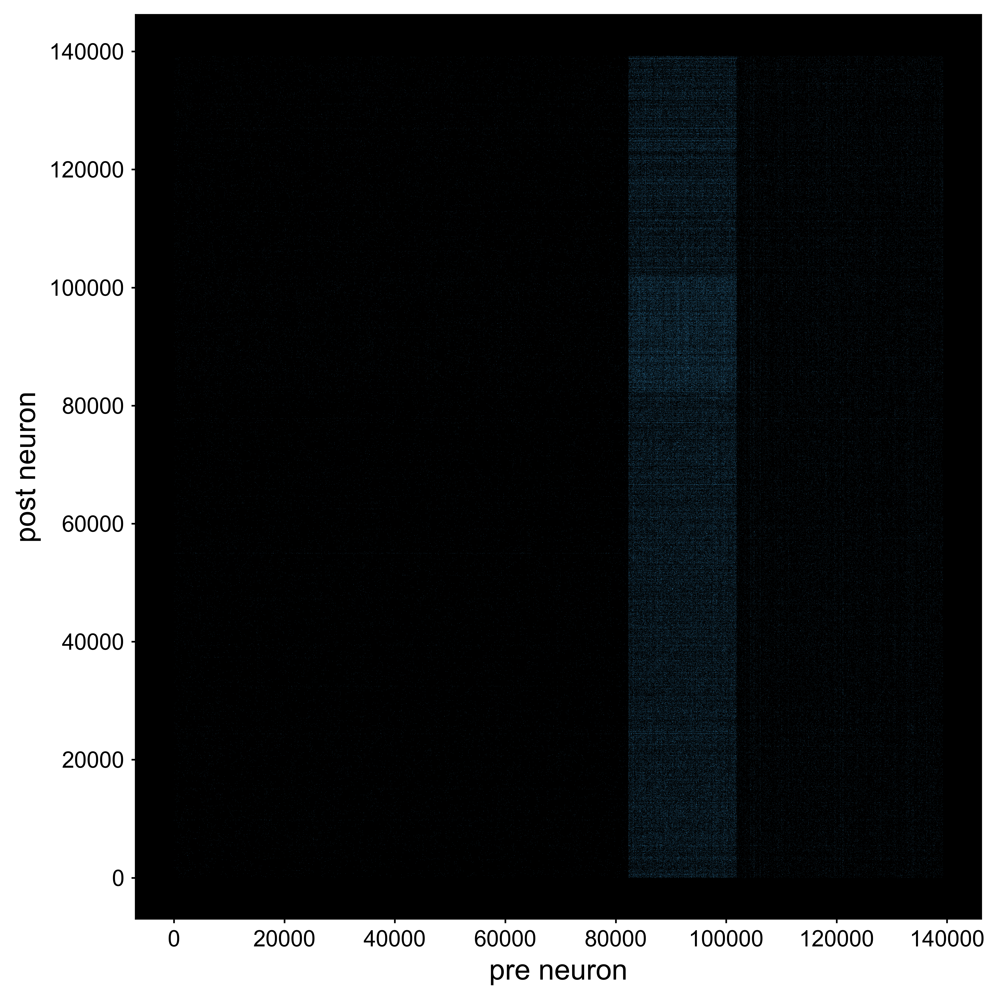

In [11]:
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(W_glut_co.col, W_glut_co.row, 's', color=Cols[1], ms=0.1)

plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency_glut.png')
plt.show()

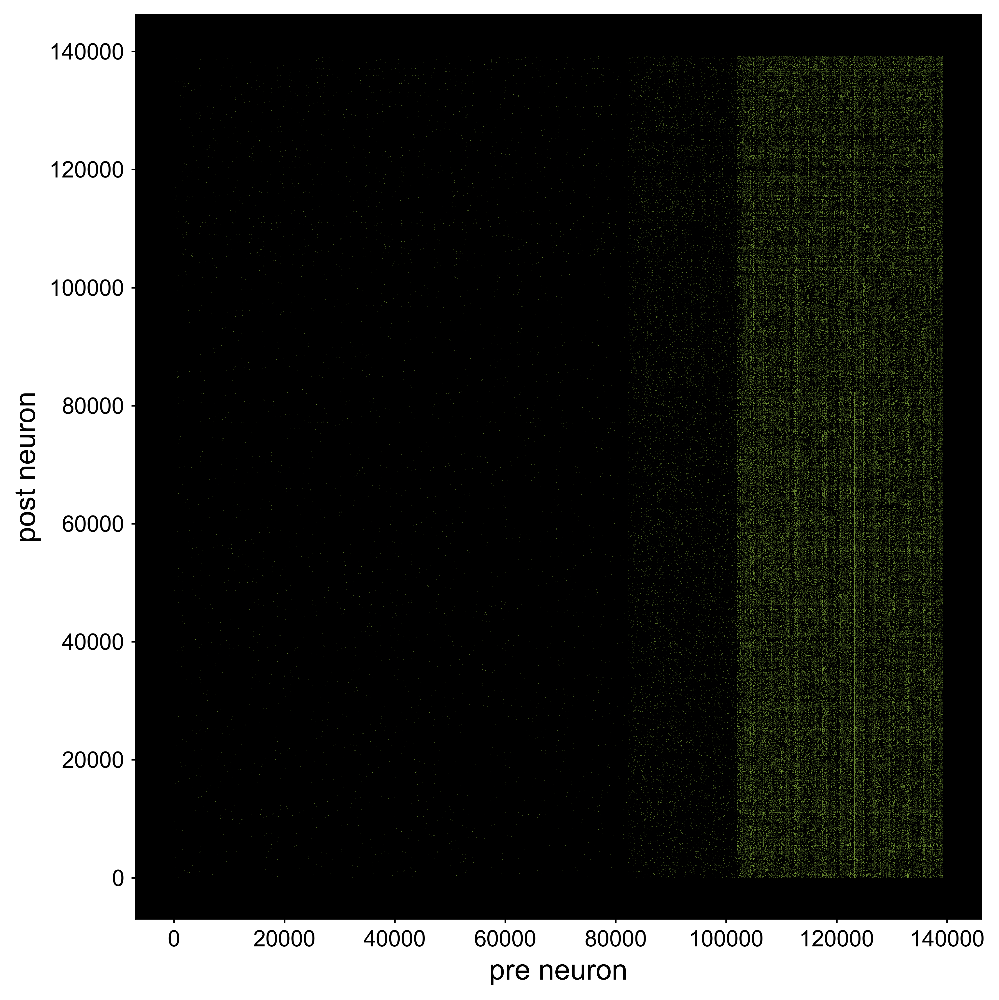

In [12]:
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(W_gaba_co.col, W_gaba_co.row, 's', color=Cols[2], ms=0.1)

plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency_gaba.png')
plt.show()

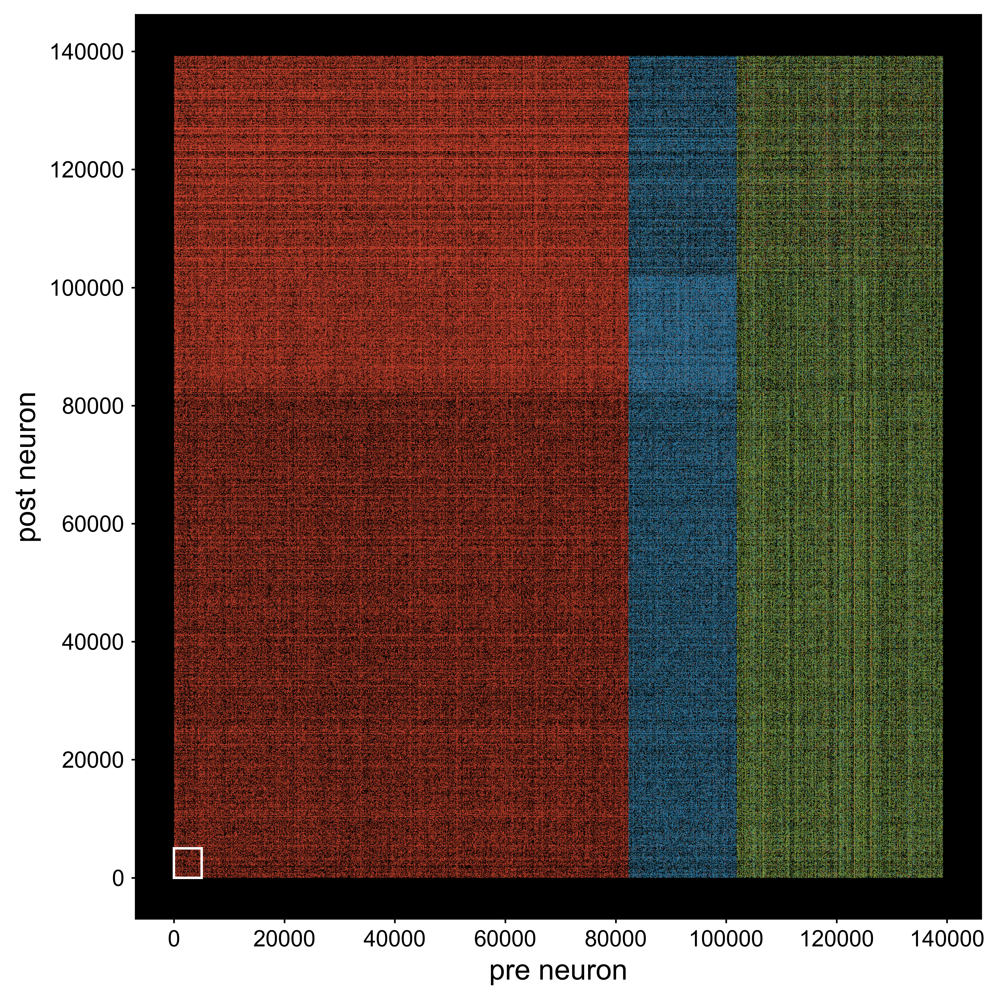

In [13]:
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(W_gaba_co.col, W_gaba_co.row, 's', color=Cols[2], ms=0.2)
ax.plot(W_glut_co.col, W_glut_co.row, 's', color=Cols[1], ms=0.2)
ax.plot(W_ach_co.col, W_ach_co.row, 's', color=Cols[0], ms=0.2)
ax.plot([5000, 5000], [0, 5000], c='w')
ax.plot( [0, 5000], [5000, 5000], c='w')
ax.plot( [0, 0], [0, 5000], c='w')
ax.plot( [0, 5000], [0, 0], c='w')
plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency_sign.png')
plt.show()

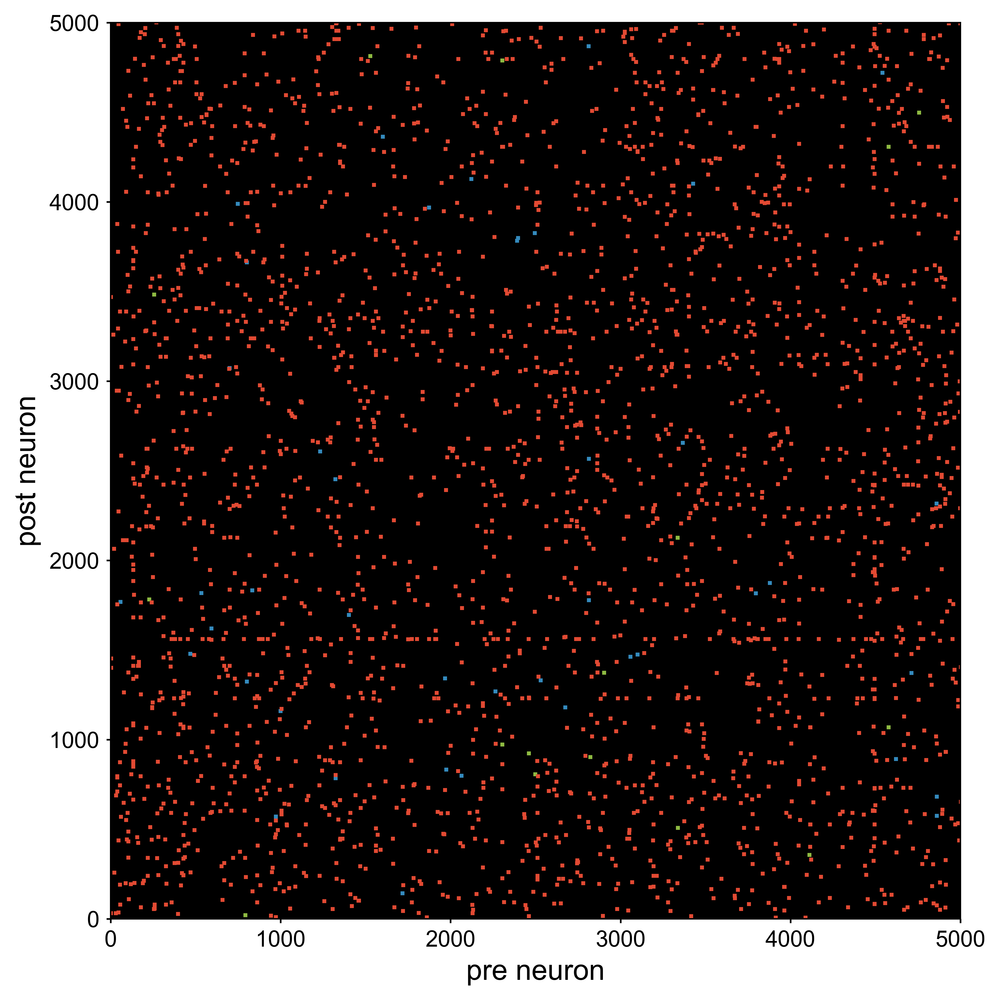

In [15]:
fig = plt.figure(dpi=600, figsize=[7,7])
ax = fig.add_subplot(111, facecolor='black')
ax.plot(W_gaba_co.col, W_gaba_co.row, 's', color=Cols[2], ms=2)
ax.plot(W_glut_co.col, W_glut_co.row, 's', color=Cols[1], ms=2)
ax.plot(W_ach_co.col, W_ach_co.row, 's', color=Cols[0], ms=2)
plt.xlim([0,5000])
plt.ylim([0,5000])
plt.xlabel('pre neuron')
plt.ylabel('post neuron')
plt.savefig(figurepath / 'adjacency_sign_zoom.png')
plt.show()

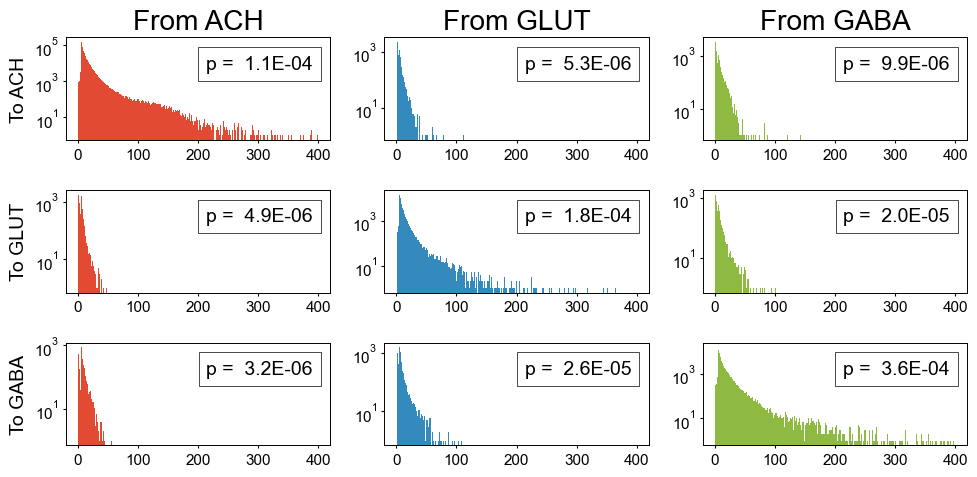

In [16]:
# Give statistics of how neurons are connected based on type

Ms = [W_ach, W_glut, W_gaba]
Ss = ['ACH', 'GLUT', 'GABA']
Cols  = ['C0', 'C1', 'C5']

fig = plt.figure(figsize=[10,5])

ci = 0
nbins=400
for ipre in range(3):
    for ipost in range(3):
        ci+=1
        ax = fig.add_subplot(3, 3, ci)

        M = Ms[ipre][np.ix_(match2[neurons.nt_type==Ss[ipre]], match2[neurons.nt_type==Ss[ipost]])]

        binM = M>0
        sp = binM.sum().sum()/(np.shape(M)[0]*np.shape(M)[1])
        ax.hist(np.ravel(M[M>0]), range=[0, nbins], bins=nbins, color=Cols[ipost])
        ax.set_yscale('log')
        if ipre==0:
            ax.set_title('From '+str(Ss[ipost]))
        if ipost==0:
            ax.set_ylabel('To '+str(Ss[ipre]))
        anchored_text = AnchoredText(f"p = {sp: .1E}", loc=1)
        ax.add_artist(anchored_text)
plt.savefig(figurepath / 'curr_hist.png')
plt.show()
